In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import kaleido

In [2]:
df = pd.read_csv("vehicles.csv")
df.head()

,city08,co2TailpipeGpm,comb08,cylinders,displ,drive,engId,eng_dscr,fuelCost08,fuelType,fuelType1,highway08,make,model,mpgData,trany,VClass,year
0,19,423.190476,21,4.0,2.0,Rear-Wheel Drive,9011,(FFS),2400,Regular,Regular Gasoline,25,Alfa Romeo,Spider Veloce 2000,Y,Manual 5-spd,Two Seaters,1985
1,9,807.909091,11,12.0,4.9,Rear-Wheel Drive,22020,(GUZZLER),4600,Regular,Regular Gasoline,14,Ferrari,Testarossa,N,Manual 5-spd,Two Seaters,1985
2,23,329.148148,27,4.0,2.2,Front-Wheel Drive,2100,(FFS),1900,Regular,Regular Gasoline,33,Dodge,Charger,Y,Manual 5-spd,Subcompact Cars,1985
3,10,807.909091,11,8.0,5.2,Rear-Wheel Drive,2850,NaN,4600,Regular,Regular Gasoline,12,Dodge,B150/B250 Wagon 2WD,N,Automatic 3-spd,Vans,1985
4,17,467.736842,19,4.0,2.2,4-Wheel or All-Wheel Drive,66031,"(FFS,TRBO)",3350,Premium,Premium Gasoline,23,Subaru,Legacy AWD Turbo,N,Manual 5-spd,Compact Cars,1993


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48031 entries, 0 to 48030
Data columns (total 18 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   city08          48031 non-null  int64  
 1   co2TailpipeGpm  48031 non-null  float64
 2   comb08          48031 non-null  int64  
 3   cylinders       47066 non-null  float64
 4   displ           47068 non-null  float64
 5   drive           46845 non-null  object 
 6   engId           48031 non-null  int64  
 7   eng_dscr        30408 non-null  object 
 8   fuelCost08      48031 non-null  int64  
 9   fuelType        48031 non-null  object 
 10  fuelType1       48031 non-null  object 
 11  highway08       48031 non-null  int64  
 12  make            48031 non-null  object 
 13  model           48031 non-null  object 
 14  mpgData         47702 non-null  object 
 15  trany           48020 non-null  object 
 16  VClass          48031 non-null  object 
 17  year            48031 non-null 

In [4]:
df['drive'].value_counts()

drive
Front-Wheel Drive             15573
Rear-Wheel Drive              15416
4-Wheel or All-Wheel Drive     6645
All-Wheel Drive                5715
4-Wheel Drive                  2385
Part-time 4-Wheel Drive         604
2-Wheel Drive                   507
Name: count, dtype: int64

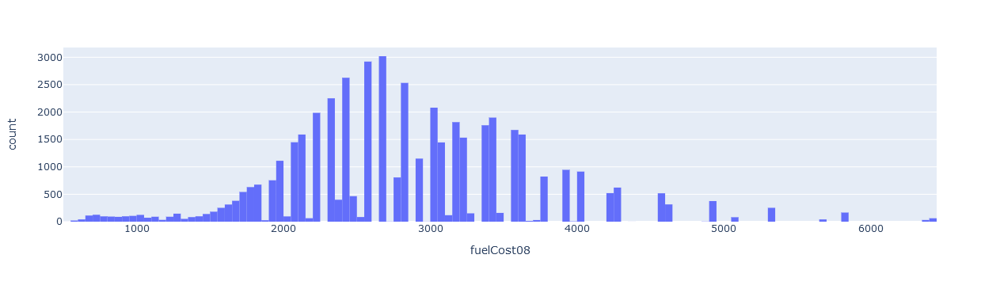

In [5]:
filtered_df = df[(df['fuelCost08'] >= 500) & (df['fuelCost08'] <= 7000)]
shape = px.histogram(filtered_df,x="fuelCost08")
shape.show()

In [6]:
# shape.write_image("plotly_histogram.svg",engine="kaleido")

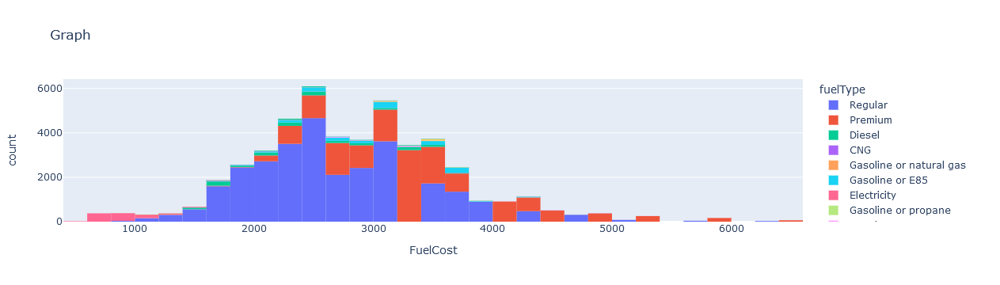

In [7]:
px.histogram(
    filtered_df,
    x="fuelCost08",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
    nbins=50,
    title="Graph"
)


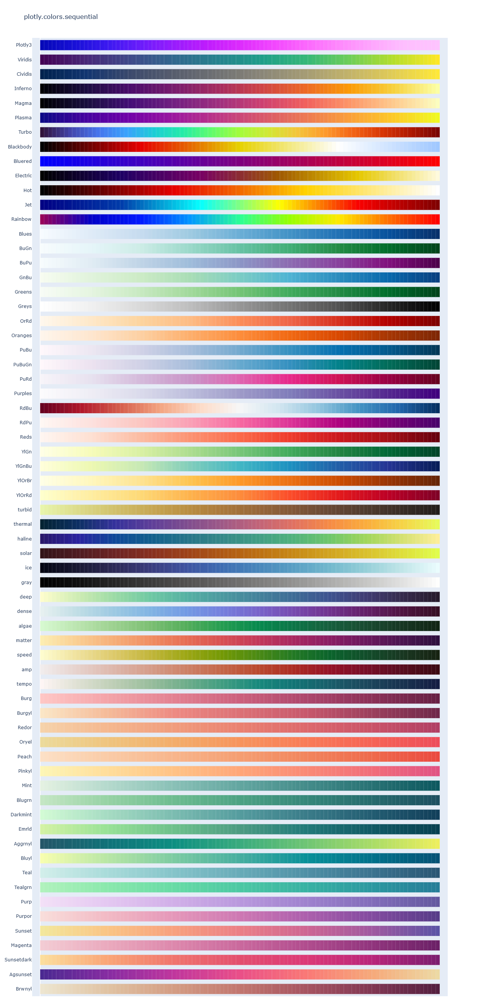

In [8]:
px.colors.sequential.swatches_continuous()

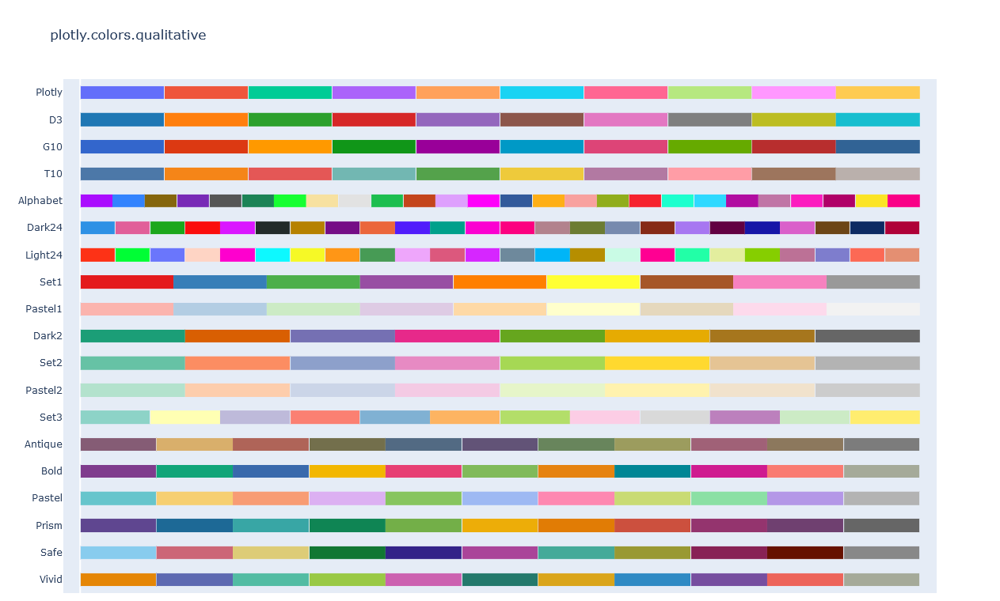

In [9]:
px.colors.qualitative.swatches()

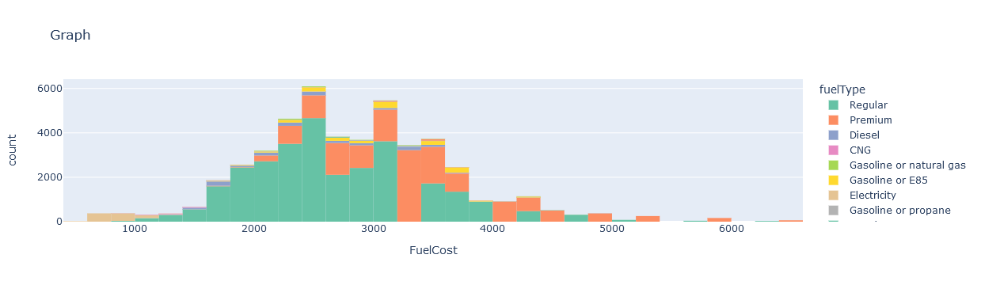

In [10]:
px.histogram(
    filtered_df,
    x="fuelCost08",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
    nbins=50,
    title="Graph",
    color_discrete_sequence=px.colors.qualitative.Set2
)


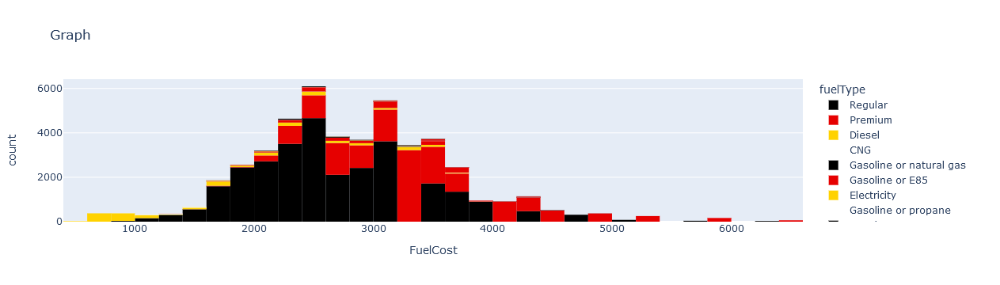

In [11]:
px.histogram(
    filtered_df,
    x="fuelCost08",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
    nbins=50,
    title="Graph",
    color_discrete_sequence=px.colors.sequential.Hot
)


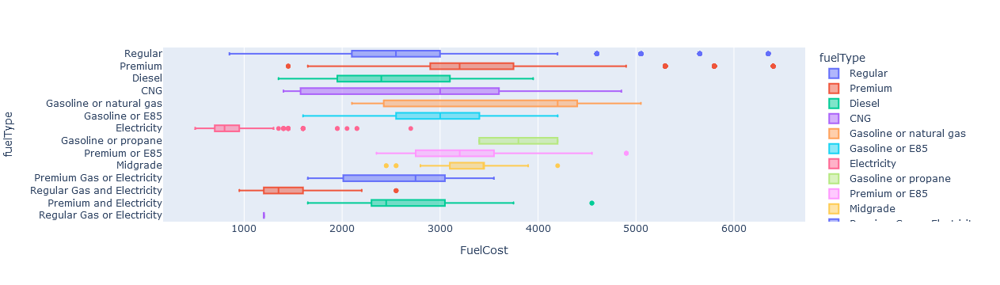

In [12]:
px.box(
    filtered_df,
    x="fuelCost08",
    y="fuelType",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
)

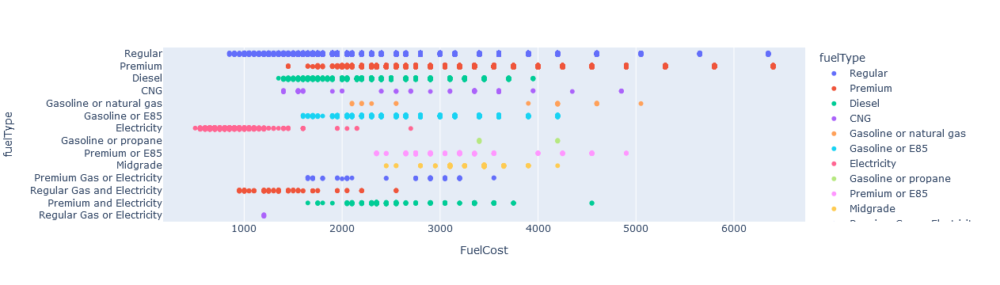

In [13]:
px.strip(
    filtered_df,
    x="fuelCost08",
    y="fuelType",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
)

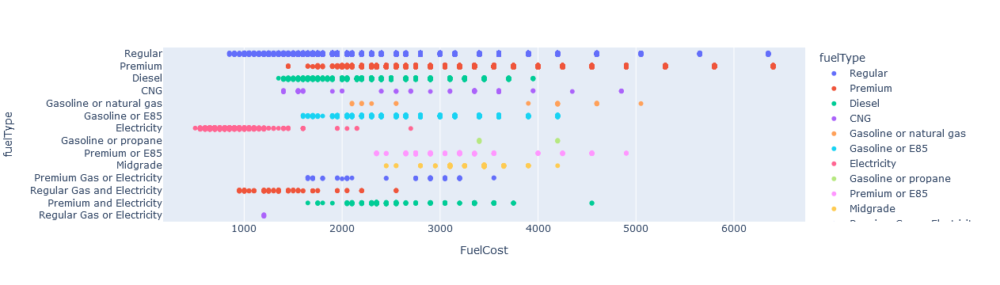

In [14]:
px.strip(
    filtered_df,
    x="fuelCost08",
    y="fuelType",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
)

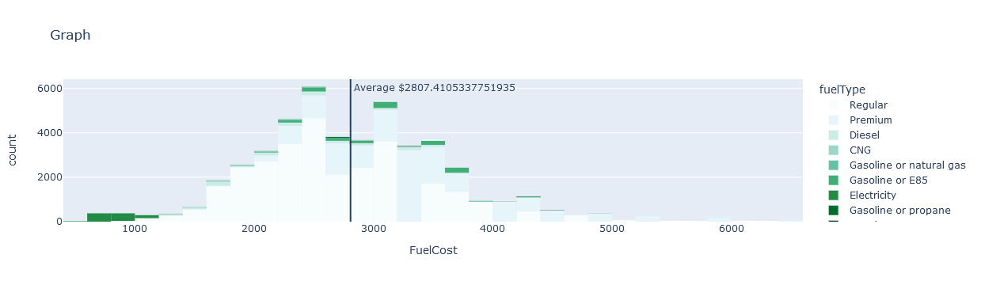

In [15]:
avg_cost = filtered_df["fuelCost08"].mean()
fig = px.histogram(
    filtered_df,
    x="fuelCost08",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
    nbins=50,
    title="Graph",
    color_discrete_sequence=px.colors.sequential.BuGn
)
fig.add_vline(x=avg_cost,annotation_text=f"Average ${avg_cost}")
fig.show()

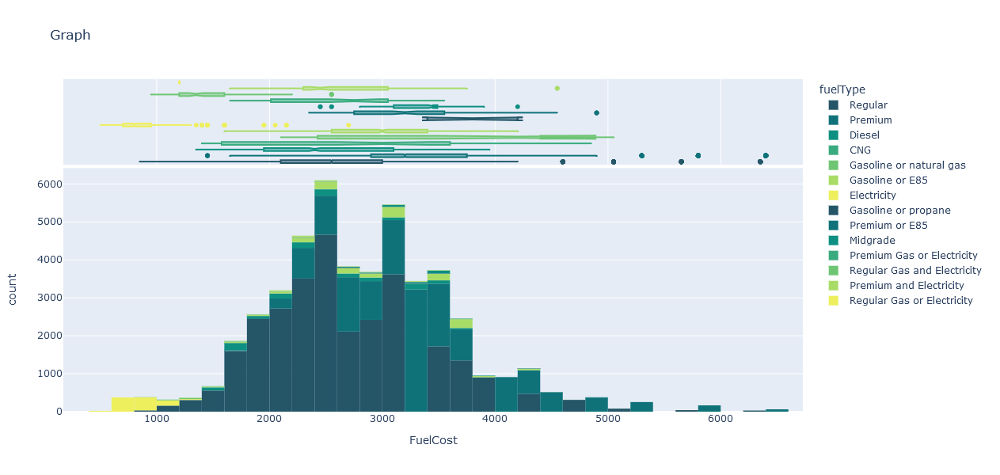

In [16]:
px.histogram(
    filtered_df,
    x="fuelCost08",
    color="fuelType",
    labels={"fuelCost08":"FuelCost","count":"Count"},
    nbins=50,
    title="Graph",
    color_discrete_sequence=px.colors.sequential.Aggrnyl,
    marginal="box",
    width=1000, height=600
)

C:\Users\Master\AppData\Local\Temp\ipykernel_13304\2223322703.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



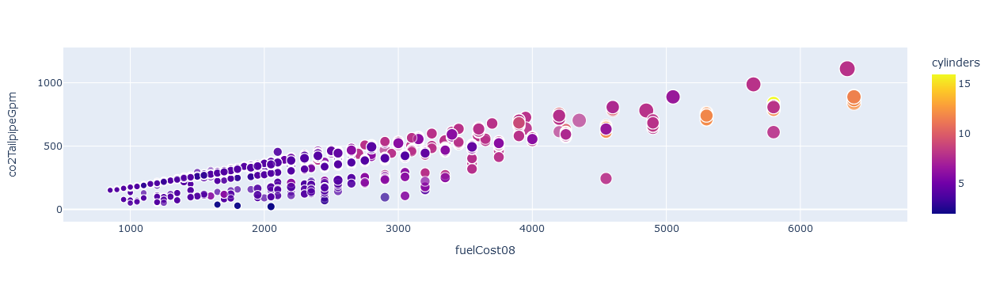

In [17]:
filtered_df["inverse_comb08"] = 1 / filtered_df["comb08"]
px.scatter(
    filtered_df.query("co2TailpipeGpm > 0"),
    x="fuelCost08" ,
    y="co2TailpipeGpm" ,
    color="cylinders",
    size="inverse_comb08",
    hover_name="model",
    hover_data=["cylinders","fuelType1"]
)

C:\Users\Master\AppData\Local\Temp\ipykernel_13304\3029871702.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



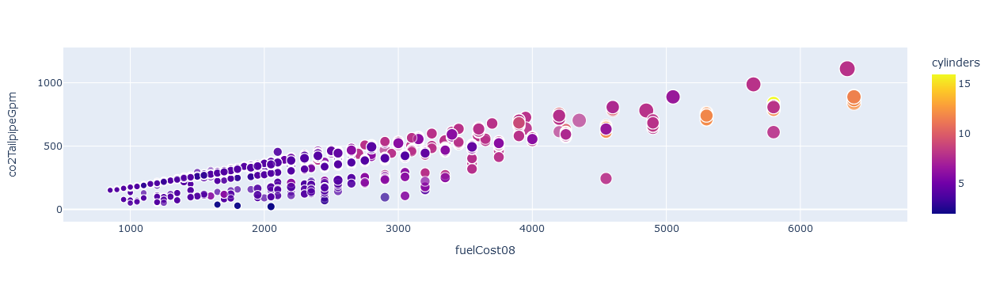

In [18]:
filtered_df["inverse_comb08"] = 1 / filtered_df["comb08"]
px.scatter(
    filtered_df.query("co2TailpipeGpm > 0"),
    x="fuelCost08" ,
    y="co2TailpipeGpm" ,
    color="cylinders",
    size="inverse_comb08",
    hover_name="model",
    hover_data={"model":True,"inverse_comb08":":.2f","fuelCost08":":$.0f"}
)

In [19]:
# px.scatter_matrix(filtered_df,dimensions=("co2TailpipeGpm","fuelCost08"),color="make")

In [20]:
avg_by_year = filtered_df.groupby(["year"],as_index=False).agg({"fuelCost08":"mean"}).round(2)
avg_by_year

,year,fuelCost08
0,1984,2773.40
1,1985,2806.44
2,1986,2826.67
3,1987,2887.84
4,1988,2869.31
5,1989,2928.52
6,1990,2930.64
7,1991,3006.58
8,1992,3011.83
9,1993,2962.36


In [21]:
px.scatter(avg_by_year,x="year",y="fuelCost08",trendline="ols",trendline_scope="overall")

In [22]:
px.scatter(avg_by_year,x="year",y="fuelCost08",trendline="lowess")

In [23]:
px.sunburst(
    filtered_df.query("year > 2020"),
    path=["year","drive"]
)

In [24]:
px.density_heatmap(filtered_df.query("year > 2020"),x="year",y="fuelCost08")

In [25]:
px.density_heatmap(filtered_df.query("year > 2020"),
                   x="year",
                   y="fuelCost08",
                   template="plotly_white",
                   marginal_y="histogram",
                   range_y=[1000,4000]
                  )

In [26]:
px.box(
    filtered_df.query("year > 2017"),
    x="fuelType",
    y="fuelCost08",
    color="cylinders",
    boxmode="group",
    facet_col="drive",
    facet_col_wrap=3,
    height=700,
    points=False
)

In [27]:
px.histogram(filtered_df.query("year > 2017"),
             facet_col="year",
             x="drive",
             facet_col_wrap=3,
             height=1000,
             nbins=50
            )